In [1]:
import pandas as pd
import numpy as np
from pandas_profiling import ProfileReport
import pandas.util.testing as tm

/opt/anaconda3/lib/python3.7/site-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


#### Attribute Information:

This research employed a binary variable, default payment (Yes = 1, No = 0), as the response variable. This study reviewed the literature and used the following 23 variables as explanatory variables:

`
X1: Amount of the given credit (NT dollar): it includes both the individual consumer credit and his/her family (supplementary) credit.
X2: Gender (1 = male; 2 = female).
X3: Education (1 = graduate school; 2 = university; 3 = high school; 4 = others).
X4: Marital status (1 = married; 2 = single; 3 = others).
X5: Age (year).
X6 - X11: History of past payment. We tracked the past monthly payment records (from April to September, 2005) as follows: X6 = the repayment status in September, 2005; X7 = the repayment status in August, 2005; . . .;X11 = the repayment status in April, 2005. The measurement scale for the repayment status is: -1 = pay duly; 1 = payment delay for one month; 2 = payment delay for two months; . . .; 8 = payment delay for eight months; 9 = payment delay for nine months and above.
X12-X17: Amount of bill statement (NT dollar). X12 = amount of bill statement in September, 2005; X13 = amount of bill statement in August, 2005; . . .; X17 = amount of bill statement in April, 2005.
X18-X23: Amount of previous payment (NT dollar). X18 = amount paid in September, 2005; X19 = amount paid in August, 2005; . . .;X23 = amount paid in April, 2005.
`

In [2]:
data = pd.read_excel("default_of_credit_card_clients.xls",skiprows=1)
#skip multi-header row of abbreviated x variables

In [3]:
data.head(10)

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default payment next month
0,1,20000,2,2,1,24,2,2,-1,-1,...,0,0,0,0,689,0,0,0,0,1
1,2,120000,2,2,2,26,-1,2,0,0,...,3272,3455,3261,0,1000,1000,1000,0,2000,1
2,3,90000,2,2,2,34,0,0,0,0,...,14331,14948,15549,1518,1500,1000,1000,1000,5000,0
3,4,50000,2,2,1,37,0,0,0,0,...,28314,28959,29547,2000,2019,1200,1100,1069,1000,0
4,5,50000,1,2,1,57,-1,0,-1,0,...,20940,19146,19131,2000,36681,10000,9000,689,679,0
5,6,50000,1,1,2,37,0,0,0,0,...,19394,19619,20024,2500,1815,657,1000,1000,800,0
6,7,500000,1,1,2,29,0,0,0,0,...,542653,483003,473944,55000,40000,38000,20239,13750,13770,0
7,8,100000,2,2,2,23,0,-1,-1,0,...,221,-159,567,380,601,0,581,1687,1542,0
8,9,140000,2,3,1,28,0,0,2,0,...,12211,11793,3719,3329,0,432,1000,1000,1000,0
9,10,20000,1,3,2,35,-2,-2,-2,-2,...,0,13007,13912,0,0,0,13007,1122,0,0


In [4]:
data.dtypes

ID                            int64
LIMIT_BAL                     int64
SEX                           int64
EDUCATION                     int64
MARRIAGE                      int64
AGE                           int64
PAY_0                         int64
PAY_2                         int64
PAY_3                         int64
PAY_4                         int64
PAY_5                         int64
PAY_6                         int64
BILL_AMT1                     int64
BILL_AMT2                     int64
BILL_AMT3                     int64
BILL_AMT4                     int64
BILL_AMT5                     int64
BILL_AMT6                     int64
PAY_AMT1                      int64
PAY_AMT2                      int64
PAY_AMT3                      int64
PAY_AMT4                      int64
PAY_AMT5                      int64
PAY_AMT6                      int64
default payment next month    int64
dtype: object

In [5]:
data.shape

(30000, 25)

In [6]:
data.iloc[:,24]

0        1
1        1
2        0
3        0
4        0
        ..
29995    0
29996    0
29997    1
29998    1
29999    1
Name: default payment next month, Length: 30000, dtype: int64

In [7]:
data.describe(include='all')

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default payment next month
count,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,...,30000.000000,30000.000000,30000.000000,30000.000000,3.000000e+04,30000.00000,30000.000000,30000.000000,30000.000000,30000.000000
mean,15000.500000,167484.322667,1.603733,1.853133,1.551867,35.485500,-0.016700,-0.133767,-0.166200,-0.220667,...,43262.948967,40311.400967,38871.760400,5663.580500,5.921163e+03,5225.68150,4826.076867,4799.387633,5215.502567,0.221200
std,8660.398374,129747.661567,0.489129,0.790349,0.521970,9.217904,1.123802,1.197186,1.196868,1.169139,...,64332.856134,60797.155770,59554.107537,16563.280354,2.304087e+04,17606.96147,15666.159744,15278.305679,17777.465775,0.415062
min,1.000000,10000.000000,1.000000,0.000000,0.000000,21.000000,-2.000000,-2.000000,-2.000000,-2.000000,...,-170000.000000,-81334.000000,-339603.000000,0.000000,0.000000e+00,0.00000,0.000000,0.000000,0.000000,0.000000
25%,7500.750000,50000.000000,1.000000,1.000000,1.000000,28.000000,-1.000000,-1.000000,-1.000000,-1.000000,...,2326.750000,1763.000000,1256.000000,1000.000000,8.330000e+02,390.00000,296.000000,252.500000,117.750000,0.000000
50%,15000.500000,140000.000000,2.000000,2.000000,2.000000,34.000000,0.000000,0.000000,0.000000,0.000000,...,19052.000000,18104.500000,17071.000000,2100.000000,2.009000e+03,1800.00000,1500.000000,1500.000000,1500.000000,0.000000
75%,22500.250000,240000.000000,2.000000,2.000000,2.000000,41.000000,0.000000,0.000000,0.000000,0.000000,...,54506.000000,50190.500000,49198.250000,5006.000000,5.000000e+03,4505.00000,4013.250000,4031.500000,4000.000000,0.000000
max,30000.000000,1000000.000000,2.000000,6.000000,3.000000,79.000000,8.000000,8.000000,8.000000,8.000000,...,891586.000000,927171.000000,961664.000000,873552.000000,1.684259e+06,896040.00000,621000.000000,426529.000000,528666.000000,1.000000


#### Observations

* Dataset includes 30,000 observations of 25 variables encoded as integer types.
* Several of these features can be renamed for better clarity. I.e. all lowercase, 'default payment next month' to 'defaulted'
* ID column can be dropped, this is likely the applicant's record id
* Bill ammount shows a negative amount for minimum, this does not make sense as bill statement should always be a positive value.. needs further investigation


In [8]:
data.columns = data.columns.str.lower()

In [9]:
data.columns

Index(['id', 'limit_bal', 'sex', 'education', 'marriage', 'age', 'pay_0',
       'pay_2', 'pay_3', 'pay_4', 'pay_5', 'pay_6', 'bill_amt1', 'bill_amt2',
       'bill_amt3', 'bill_amt4', 'bill_amt5', 'bill_amt6', 'pay_amt1',
       'pay_amt2', 'pay_amt3', 'pay_amt4', 'pay_amt5', 'pay_amt6',
       'default payment next month'],
      dtype='object')

In [10]:
data = data.drop('id',axis=1)

In [11]:
data.rename(columns={'default payment next month':'defaulted'},inplace=True)

In [12]:
data.columns

Index(['limit_bal', 'sex', 'education', 'marriage', 'age', 'pay_0', 'pay_2',
       'pay_3', 'pay_4', 'pay_5', 'pay_6', 'bill_amt1', 'bill_amt2',
       'bill_amt3', 'bill_amt4', 'bill_amt5', 'bill_amt6', 'pay_amt1',
       'pay_amt2', 'pay_amt3', 'pay_amt4', 'pay_amt5', 'pay_amt6',
       'defaulted'],
      dtype='object')

* Confirm if the categorical variables (gender, education, marital status) and age are recorded correctly

In [13]:
data.sex.value_counts()

2    18112
1    11888
Name: sex, dtype: int64

In [14]:
data.education.value_counts()

2    14030
1    10585
3     4917
5      280
4      123
6       51
0       14
Name: education, dtype: int64

Consider that only these values are applicable: 1 = graduate school; 2 = university; 3 = high school; 4 = others, then 4,5,6,0 can be categorized as other. 

In [15]:
data.education = data.education.apply(lambda x: 4 if x in [0,4,5,6] else x)

In [16]:
data.education.value_counts()

2    14030
1    10585
3     4917
4      468
Name: education, dtype: int64

In [17]:
data.marriage.value_counts()

2    15964
1    13659
3      323
0       54
Name: marriage, dtype: int64

In [18]:
data = data[~data.marriage.isin([0,3])]

#### Missing Values

In [19]:
data.isnull().sum()

limit_bal    0
sex          0
education    0
marriage     0
age          0
pay_0        0
pay_2        0
pay_3        0
pay_4        0
pay_5        0
pay_6        0
bill_amt1    0
bill_amt2    0
bill_amt3    0
bill_amt4    0
bill_amt5    0
bill_amt6    0
pay_amt1     0
pay_amt2     0
pay_amt3     0
pay_amt4     0
pay_amt5     0
pay_amt6     0
defaulted    0
dtype: int64

There does not seem to be any missing values in this dataset

#### Outliers

In [20]:
import seaborn as sns

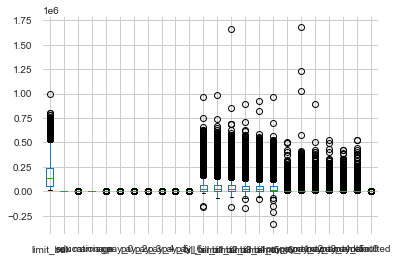

In [21]:
data.boxplot()

We see that a few variables have outliers in both directions. We can bin each variable to identify the thresholds to drop for each.

In [22]:
for i in range(0,len(data.columns)):
    print(data[data.columns[i]].value_counts(bins=10, sort=False))

(9009.999, 109000.0]     12250
(109000.0, 208000.0]      7798
(208000.0, 307000.0]      5031
(307000.0, 406000.0]      2745
(406000.0, 505000.0]      1593
(505000.0, 604000.0]       127
(604000.0, 703000.0]        56
(703000.0, 802000.0]        22
(802000.0, 901000.0]         0
(901000.0, 1000000.0]        1
Name: limit_bal, dtype: int64
(0.998, 1.1]    11743
(1.1, 1.2]          0
(1.2, 1.3]          0
(1.3, 1.4]          0
(1.4, 1.5]          0
(1.5, 1.6]          0
(1.6, 1.7]          0
(1.7, 1.8]          0
(1.8, 1.9]          0
(1.9, 2.0]      17880
Name: sex, dtype: int64
(0.996, 1.3]    10531
(1.3, 1.6]          0
(1.6, 1.9]          0
(1.9, 2.2]      13862
(2.2, 2.5]          0
(2.5, 2.8]          0
(2.8, 3.1]       4770
(3.1, 3.4]          0
(3.4, 3.7]          0
(3.7, 4.0]        460
Name: education, dtype: int64
(0.998, 1.1]    13659
(1.1, 1.2]          0
(1.2, 1.3]          0
(1.3, 1.4]          0
(1.4, 1.5]          0
(1.5, 1.6]          0
(1.6, 1.7]          0
(1.7, 1.8]  

In [23]:
drop_limit = data[data.limit_bal > 802000].index
drop_pay_2 = data[data.pay_2 > 7.0].index
drop_pay_3 = data[data.pay_3 > 7.0].index
drop_pay_4 = data[data.pay_4 > 7.0].index
drop_pay_5 = data[data.pay_5 > 7.0].index
drop_pay_6 = data[data.pay_6 > 7.0].index
drop_bill_amt1 = data[data.bill_amt1 > 625483.7].index
drop_bill_amt2 = data[data.bill_amt2 > 667818.6].index
drop_bill_amt3 = data[data.bill_amt3 > 571277.2].index
drop_bill_amt4 = data[data.bill_amt4 > 573110.2].index
drop_bill_amt5 = data[data.bill_amt5 > 523769.0].index
drop_bill_amt6 = data[data.bill_amt6 > 571283.9].index
drop_pay_amt1 = data[data.pay_amt1 > 303000.0].index
drop_pay_amt2 = data[data.pay_amt2 > 336851.8].index
drop_pay_amt3 = data[data.pay_amt3 > 179208.0].index
drop_pay_amt4 = data[data.pay_amt4 > 211558.8].index
drop_pay_amt5 = data[data.pay_amt5 > 213264.5].index
drop_pay_amt6 = data[data.pay_amt6 > 211466.4].index

In [24]:
dropIndexes = drop_limit | drop_pay_2 | drop_pay_3 | drop_pay_4 | drop_pay_5 | drop_pay_6 | drop_bill_amt1 | drop_bill_amt2 | drop_bill_amt3 | drop_bill_amt4 | drop_bill_amt5 | drop_bill_amt6 | drop_pay_amt1 | drop_pay_amt2 | drop_pay_amt3 | drop_pay_amt4 | drop_pay_amt5 | drop_pay_amt6

In [25]:
len(dropIndexes)

164

In [26]:
data.drop(dropIndexes , inplace=True)

In [27]:
for i in range(0,len(data.columns)):
    print(data[data.columns[i]].value_counts(bins=10, sort=False))

(9209.999, 89000.0]     10565
(89000.0, 168000.0]      6221
(168000.0, 247000.0]     5779
(247000.0, 326000.0]     3042
(326000.0, 405000.0]     2128
(405000.0, 484000.0]      782
(484000.0, 563000.0]      835
(563000.0, 642000.0]       67
(642000.0, 721000.0]       30
(721000.0, 800000.0]       10
Name: limit_bal, dtype: int64
(0.998, 1.1]    11663
(1.1, 1.2]          0
(1.2, 1.3]          0
(1.3, 1.4]          0
(1.4, 1.5]          0
(1.5, 1.6]          0
(1.6, 1.7]          0
(1.7, 1.8]          0
(1.8, 1.9]          0
(1.9, 2.0]      17796
Name: sex, dtype: int64
(0.996, 1.3]    10459
(1.3, 1.6]          0
(1.6, 1.9]          0
(1.9, 2.2]      13791
(2.2, 2.5]          0
(2.5, 2.8]          0
(2.8, 3.1]       4752
(3.1, 3.4]          0
(3.4, 3.7]          0
(3.7, 4.0]        457
Name: education, dtype: int64
(0.998, 1.1]    13581
(1.1, 1.2]          0
(1.2, 1.3]          0
(1.3, 1.4]          0
(1.4, 1.5]          0
(1.5, 1.6]          0
(1.6, 1.7]          0
(1.7, 1.8]          0


Create a profile report

In [28]:
profile = ProfileReport(data,title="Defaults Client Profiling Report",explorative=True)

In [29]:
%%time
profile.to_notebook_iframe()

CPU times: user 1min 30s, sys: 2.97 s, total: 1min 33s
Wall time: 1min 47s


In [30]:
profile.to_file("defaults_eda_summary.html")

In [32]:
data.to_csv("default_of_credit_card_clients.csv",index=False)